# Lecture 4 - preperation

## Contents
1. [Exercise II - Solutions](#exersice-ii)
2. [DifferentialEquations.jl](#differentialequationsjl)
1. [Parametric Types](#parametric-types)
2. [Parametric Methods](#parametric-methods)
3. [Structs are Immutable](#structs-immutable)
4. [Further Reading](#further-reading)

In [26]:
using DifferentialEquations, Plots

function harmonic_oscillator(u,p,t)
    m, k = p 
    x, v = u 
    dx = v 
    dv = - (k/m)*x 
    [dx, dv]
end 
x0 = [1.,0.]
p = [1.,1.]
prob = ODEProblem(harmonic_oscillator, x0, (0.,100.),p)

sol = solve(prob)



retcode: Success
Interpolation: specialized 4th order "free" interpolation, specialized 2nd order "free" stiffness-aware interpolation
t: 127-element Vector{Float64}:
   0.0
   0.0009990009990009992
   0.010989010989010992
   0.07985922249873038
   0.2403882280626971
   0.48125583199780264
   0.7872724750204353
   1.1770558023021032
   1.630266513673432
   2.1040018658103854
   ⋮
  93.23641173031487
  94.0387732034249
  94.93344578261068
  95.74820105690283
  96.63756963198891
  97.46802481099532
  98.34366765442643
  99.19188863993591
 100.0
u: 127-element Vector{Vector{Float64}}:
 [1.0, 0.0]
 [0.9999995009985435, -0.000999000832833342]
 [0.9999396214263468, -0.010988789821184269]
 [0.9968129466114029, -0.07977436592568168]
 [0.9712456180254766, -0.23807970964822978]
 [0.8864142948207253, -0.4628927349710369]
 [0.7057801319307302, -0.7084309070362929]
 [0.3836450082688139, -0.9234805642321077]
 [-0.05943639522180999, -0.9982319800633562]
 [-0.5082985573738581, -0.8611807771069901]
 ⋮


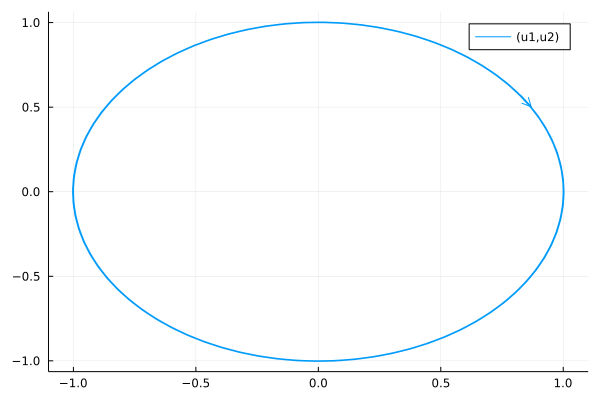

In [9]:
plot(sol, vars=(1,2), arrow=true, xlabel="x", ylabel="y")


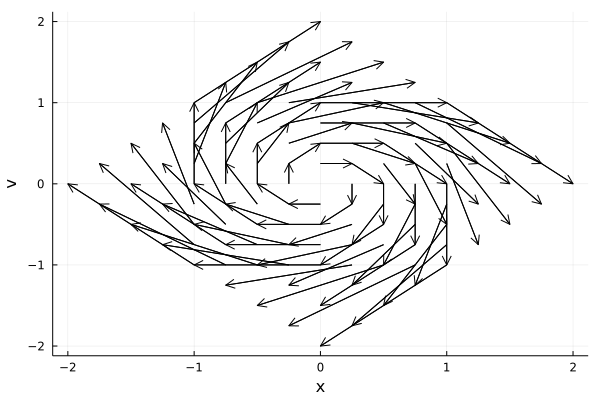

In [62]:
x=-1:0.25:1 
v=-1:0.25:1 

# we do a meshgrid 
x_grid = x' .* ones(length(x))
v_grid = ones(length(v))' .* v

dx_grid = similar(x_grid)
dv_grid = similar(v_grid)
for i ∈ eachindex(x_grid)
    dx_grid[i], dv_grid[i] = 
    harmonic_oscillator([x_grid[i], v_grid[i]],p,0.)
end

quiver(x_grid,v_grid,quiver=(dx_grid, dv_grid), 
color=:black, xlabel="x", ylabel="v")

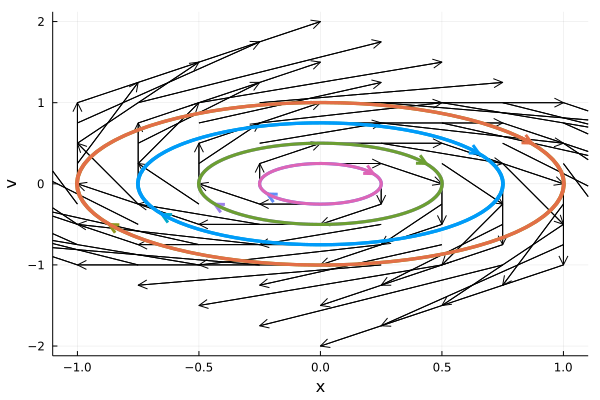

In [63]:

quiver(x_grid,v_grid,quiver=(dx_grid, dv_grid), 
color=:black)

u_0 = hcat(-1:0.25:1, zeros(length(x)))
for i ∈ 1:size(u_0,1)
    plot!(solve(remake(prob, u0=u_0[i,:])), 
    vars=(1,2), arrows=true, legend=nothing, 
    linewidth=3, xlabel="x", ylabel="v")
end 
plot!(0,0)

In [81]:
v_grid

9×9 Matrix{Float64}:
 -1.0   -1.0   -1.0   -1.0   -1.0   -1.0   -1.0   -1.0   -1.0
 -0.75  -0.75  -0.75  -0.75  -0.75  -0.75  -0.75  -0.75  -0.75
 -0.5   -0.5   -0.5   -0.5   -0.5   -0.5   -0.5   -0.5   -0.5
 -0.25  -0.25  -0.25  -0.25  -0.25  -0.25  -0.25  -0.25  -0.25
  0.0    0.0    0.0    0.0    0.0    0.0    0.0    0.0    0.0
  0.25   0.25   0.25   0.25   0.25   0.25   0.25   0.25   0.25
  0.5    0.5    0.5    0.5    0.5    0.5    0.5    0.5    0.5
  0.75   0.75   0.75   0.75   0.75   0.75   0.75   0.75   0.75
  1.0    1.0    1.0    1.0    1.0    1.0    1.0    1.0    1.0

In [120]:
function f(u,p,t)
    a, = p
    x, y = u 
    [a*x, -y]
end 
x0 = [1.,0.]
p = [-2.]
prob = ODEProblem(f, x0, (0.,2.),p)


ODEProblem with uType Vector{Float64} and tType Float64. In-place: false
timespan: (0.0, 2.0)
u0: 2-element Vector{Float64}:
 1.0
 0.0

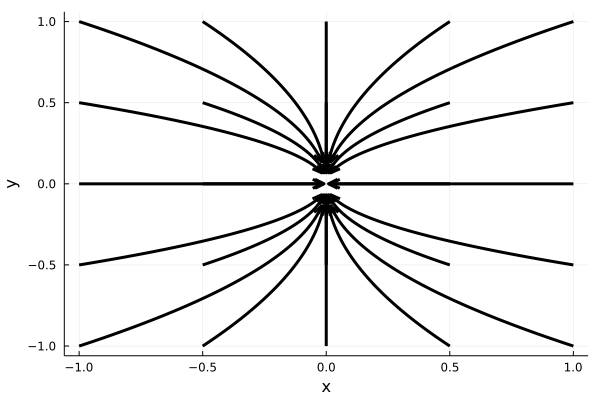

In [122]:
x=-1:0.5:1 
y=-1:0.5:1 

# we do a meshgrid 
x_grid = x' .* ones(length(x))
y_grid = ones(length(v))' .* y
p = [-2.]
plot(0,0)
for i ∈ eachindex(x_grid)
    plot!(solve(remake(prob; u0=[x_grid[i],y_grid[i]],p=p)), 
    vars=(1,2), color=:black, arrows=true, legend=nothing, 
    linewidth=3, xlabel="x", ylabel="y",xlims=[-1,1],ylims=[-1,1])

end 
plot!(0,0)

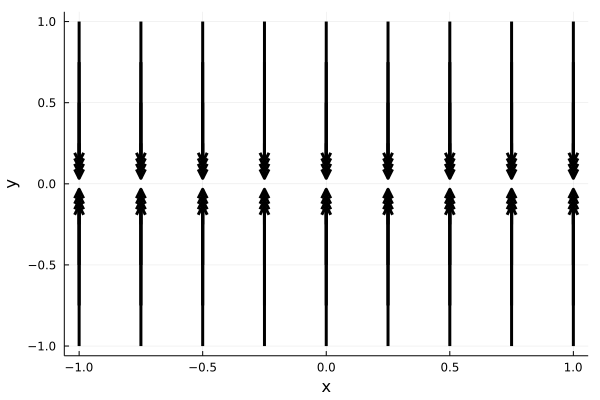

In [124]:
x=-1:0.25:1 
y=-1:0.25:1 
x_grid = x' .* ones(length(x))
y_grid = ones(length(v))' .* y
p = [0.]
plot(0,0)
for i ∈ eachindex(x_grid)
    plot!(solve(remake(prob; u0=[x_grid[i],y_grid[i]],p=p)), 
    vars=(1,2), color=:black, arrows=true, legend=nothing, 
    linewidth=3, xlabel="x", ylabel="y",xlims=[-1,1],ylims=[-1,1])

end 
plot!(0,0)

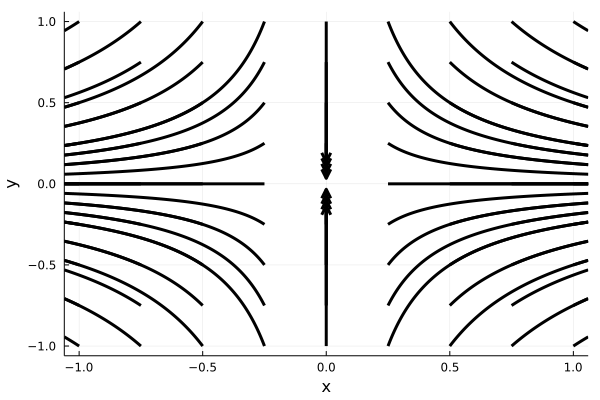

In [125]:
p = [1.]
plot(0,0)
for i ∈ eachindex(x_grid)
    plot!(solve(remake(prob; u0=[x_grid[i],y_grid[i]],p=p)), 
    vars=(1,2), color=:black, arrows=true, legend=nothing, 
    linewidth=3, xlabel="x", ylabel="y",xlims=[-1,1],ylims=[-1,1])

end 
plot!(0,0)

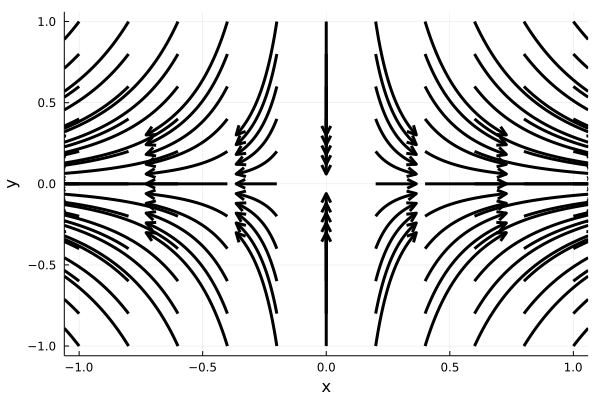

In [136]:
x=-1:0.2:1 
y=-1:0.2:1 
x_grid = x' .* ones(length(x))
y_grid = ones(length(y))' .* y
p = [0.5]
plot(0,0)
for i ∈ eachindex(x_grid)
    plot!(solve(remake(prob; tspan=(0.,1.2),u0=[x_grid[i],y_grid[i]],p=p)), 
    vars=(1,2), color=:black, arrows=true, legend=nothing, 
    linewidth=3, xlabel="x", ylabel="y",xlims=[-1,1],ylims=[-1,1])

end 
plot!(0,0)

In [164]:
function rabbits_vs_sheep(du,u,p,t)
    r, s = u 
    du[1] = r*(3 - r - 2*s)
    du[2] = s*(2 - r - s)
end 
    
x0 = [1.,1.]
prob = ODEProblem(rabbits_vs_sheep, x0, (0.,10.))


ODEProblem with uType Vector{Float64} and tType Float64. In-place: true
timespan: (0.0, 10.0)
u0: 2-element Vector{Float64}:
 1.0
 1.0

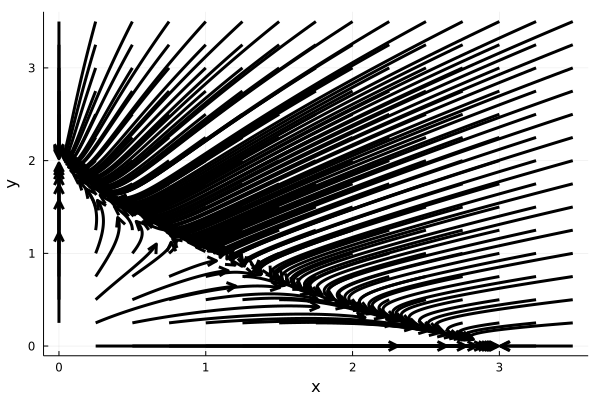

In [142]:
x=0:0.25:3.5
y=0:0.25:3.5
x_grid = x' .* ones(length(x))
y_grid = ones(length(y))' .* y
p = [0.5]
plot(0,0)
for i ∈ eachindex(x_grid)
    plot!(solve(remake(prob; tspan=(0.,1.2),u0=[x_grid[i],y_grid[i]])), 
    vars=(1,2), color=:black, arrows=true, legend=nothing, 
    linewidth=3, xlabel="x", ylabel="y",xlims=[0,3.5],ylims=[0,3.5])

end 
plot!(0,0)

We can make this a bit prettier by not using the full meshgrid 

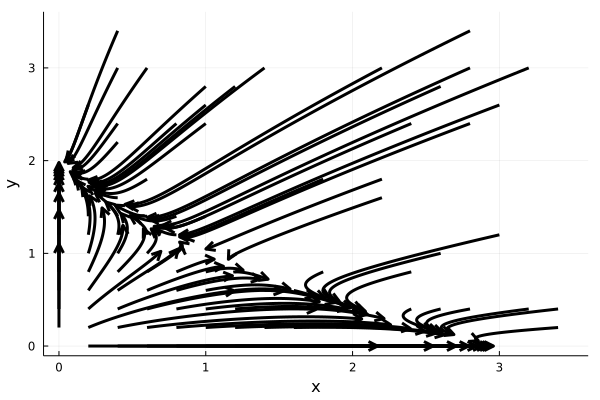

In [163]:
x=0:0.2:3.5
y=0:0.2:3.5
x_grid = x' .* ones(length(x))
y_grid = ones(length(y))' .* y
p = [0.5]
plot(0,0)
for i ∈ eachindex(x_grid)

    if y_grid[i] > (2 - x_grid[i]) # skip most points in the upper right part
        if rand() < 0.85
            continue
        end 
    end 

    plot!(solve(remake(prob; tspan=(0.,1.2),u0=[x_grid[i],y_grid[i]])), 
    vars=(1,2), color=:black, arrows=true, legend=nothing, 
    linewidth=3, xlabel="x", ylabel="y",xlims=[0,3.5],ylims=[0,3.5])

end 
plot!(0,0)


We have stable nodes / sinks at $(0,2)$ and $(3,0)$, an unstable node at $(0,0)$ and a saddle point at $(1,1)$. $(0,2)$ and $(3,0)$ are only two stable points and eventually all trajectories will end in of them. Are part of the phase space whose initial conditions lead to one attractor (here the stable node) is called its basin of attraction (often short just basin). This model therefore has two different basins of attraction. One to the top left of the stable manifold of the saddle point. All trajectories that start there will lead to the stable node at $(3,0)$. The other at the lower right will lead to the stable node at $(0,2)$.




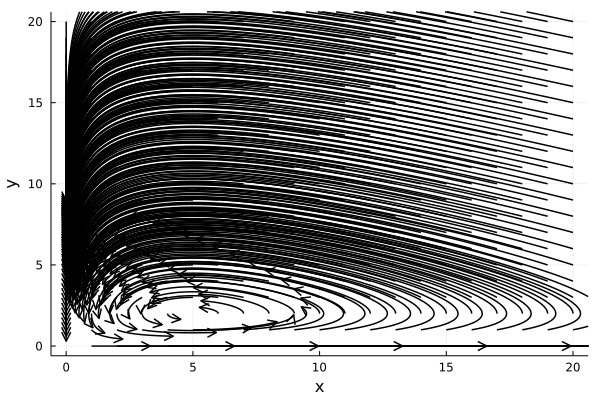

In [149]:

function lotka_volterra!(dx,x,p,t) # the same as in the exercise 2 solutions 
    α, β, γ, δ = p 
    dx[1] = (α*x[1] - β*x[1]*x[2])
    dx[2] = -γ*x[2] + δ*x[1]*x[2]
end

x₀ = [20., 5.] 
α = 1.
β = 0.5
γ = 1.
δ = 0.2
p = [α, β, γ, δ] 
tspan = (0.,20.)
prob = ODEProblem(lotka_volterra!, x₀, tspan, p)


x=0:1.:20.
y=0:1.:20.
x_grid = x' .* ones(length(x))
y_grid = ones(length(y))' .* y
plot(0,0)
for i ∈ eachindex(x_grid)
    plot!(solve(remake(prob; tspan=(0.,1.2),u0=[x_grid[i],y_grid[i]])), 
    vars=(1,2), color=:black, arrows=true, legend=nothing, 
    linewidth=1.5, xlabel="x", ylabel="y",xlims=[0,20.],ylims=[0,20.])

end 
plot!(0,0)